<center><h1> An Introduction to the Dataset </h1>
    <h3>McDonald's Store Reviews (US)</h3>
    <br>
This notebook serves as an example of how the McDonald's US Store Reviews dataset can be utilized, allowing other users to quickly grasp its potential applications. By performing simple sentiment analysis using TextBlob, the notebook showcases a basic approach to understanding the sentiment expressed in the reviews. It's important to note that sentiment analysis can be accomplished using various advanced techniques that offer higher accuracy and nuanced insights. Users are encouraged to explore more sophisticated methodologies, such as machine learning-based models or deep learning techniques, to further enhance the accuracy and depth of sentiment analysis for more comprehensive and detailed interpretations of the reviews. </center>

## Importing necessary libraries

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from textblob import TextBlob

## Load the dataset

In [2]:
# Load the dataset with specified encoding
df = pd.read_csv("/kaggle/input/mcdonalds-store-reviews/McDonald_s_Reviews.csv", encoding="latin-1")

# BUSINESS ANALYTICS 

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33396 entries, 0 to 33395
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   reviewer_id    33396 non-null  int64  
 1   store_name     33396 non-null  object 
 2   category       33396 non-null  object 
 3   store_address  33396 non-null  object 
 4   latitude       32736 non-null  float64
 5   longitude      32736 non-null  float64
 6   rating_count   33396 non-null  object 
 7   review_time    33396 non-null  object 
 8   review         33396 non-null  object 
 9   rating         33396 non-null  object 
dtypes: float64(2), int64(1), object(7)
memory usage: 2.5+ MB


In [4]:
df.isna().sum().sort_values(ascending = False)

latitude         660
longitude        660
reviewer_id        0
store_name         0
category           0
store_address      0
rating_count       0
review_time        0
review             0
rating             0
dtype: int64

In [5]:
# Drop rows with any NaN values
df.dropna(inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32736 entries, 0 to 33395
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   reviewer_id    32736 non-null  int64  
 1   store_name     32736 non-null  object 
 2   category       32736 non-null  object 
 3   store_address  32736 non-null  object 
 4   latitude       32736 non-null  float64
 5   longitude      32736 non-null  float64
 6   rating_count   32736 non-null  object 
 7   review_time    32736 non-null  object 
 8   review         32736 non-null  object 
 9   rating         32736 non-null  object 
dtypes: float64(2), int64(1), object(7)
memory usage: 2.7+ MB


## Performing sentiment analysis on reviews

*Simple sentiment analysis is performed on the review text using TextBlob*

In [6]:
df['sentiment'] = df['review'].apply(lambda x: TextBlob(x).sentiment.polarity)
avg_sentiment_by_rating = df.groupby('rating')['sentiment'].mean()

# Top 10 positive reviews
top_positive_reviews = df.nlargest(10, 'sentiment')

# Top 10 negative reviews
top_negative_reviews = df.nsmallest(10, 'sentiment')

In [7]:
# Output the results
print("Average sentiment by rating:")
print(avg_sentiment_by_rating)

Average sentiment by rating:
rating
1 star    -0.209098
2 stars   -0.091885
3 stars    0.092729
4 stars    0.388047
5 stars    0.536256
Name: sentiment, dtype: float64


In [8]:
print("\nTop 10 positive reviews:")
print(top_positive_reviews[['store_name', 'review', 'rating']])


Top 10 positive reviews:
     store_name                                             review   rating
98   McDonald's  Allways has the best Fries and Ice cream in th...  5 stars
196  McDonald's  Its ice cream cone is the best part of this br...  4 stars
264  McDonald's  Excellent breakfast sandwiches and Carmel frappes  5 stars
368  McDonald's      Best and fastest drive through in the morning  5 stars
381  McDonald's                   Good food as always... MURIKA!!!  3 stars
394  McDonald's                 Tasty! Excellent customer service!  5 stars
406  McDonald's                                  Excellent Drummer  5 stars
436  McDonald's                                          Excellent  5 stars
544  McDonald's                                        Excellent!!  5 stars
560  McDonald's                                          Excellent  5 stars


In [9]:
print("\nTop 10 negative reviews:")
print(top_negative_reviews[['store_name', 'review', 'rating']])


Top 10 negative reviews:
     store_name                                             review   rating
10   McDonald's  Worst McDonaldï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿...   1 star
114  McDonald's  Terrible service didnï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï...   1 star
301  McDonald's                                 Very bad service!!   1 star
447  McDonald's                Terrible over the phone experience.  2 stars
457  McDonald's                             The food was horrible!   1 star
499  McDonald's                        Its McDonald's, it's boring  3 stars
511  McDonald's                                   Horrible service   1 star
522  McDonald's                                              Awful   1 star
535  McDonald's                                           HORRIBLE   1 star
828  McDonald's  If I could give this place a ZERO I would!!! N...   1 star


## Visualize average sentiment by rating

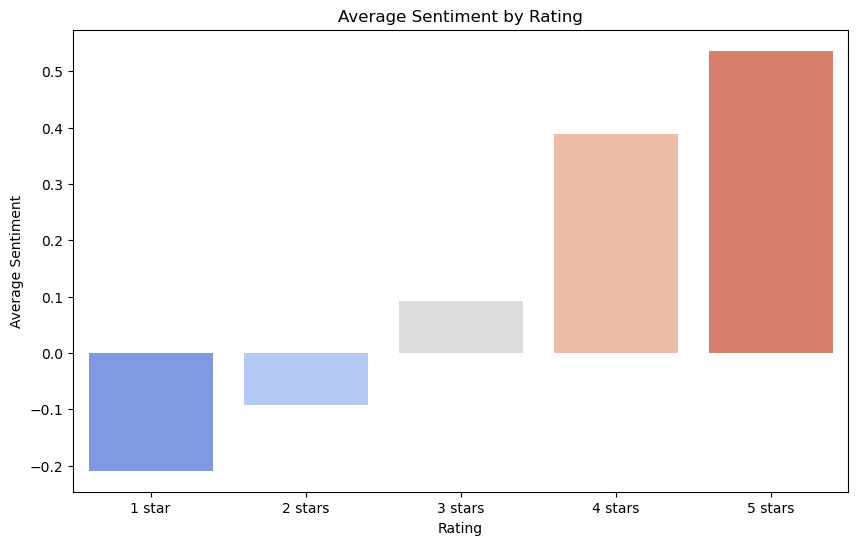

In [10]:
color_palette = sns.color_palette("coolwarm", len(avg_sentiment_by_rating))

plt.figure(figsize=(10, 6))
sns.barplot(x=avg_sentiment_by_rating.index, y=avg_sentiment_by_rating.values, palette=color_palette)
plt.xlabel('Rating')
plt.ylabel('Average Sentiment')
plt.title('Average Sentiment by Rating')
plt.show()

# Location-based analysis

In [11]:
# Define a mapping dictionary to map string ratings to numeric values
rating_mapping = {'1 star': 1, '2 stars': 2, '3 stars': 3, '4 stars': 4, '5 stars': 5}

# Apply the mapping to convert the 'rating' column
df['rating'] = df['rating'].map(rating_mapping)


## Visualization with Scatter Plot
Create a scatter plot to visualize the locations of the stores based on latitude and longitude. This will provide a general overview of the distribution of McDonald's stores across regions.

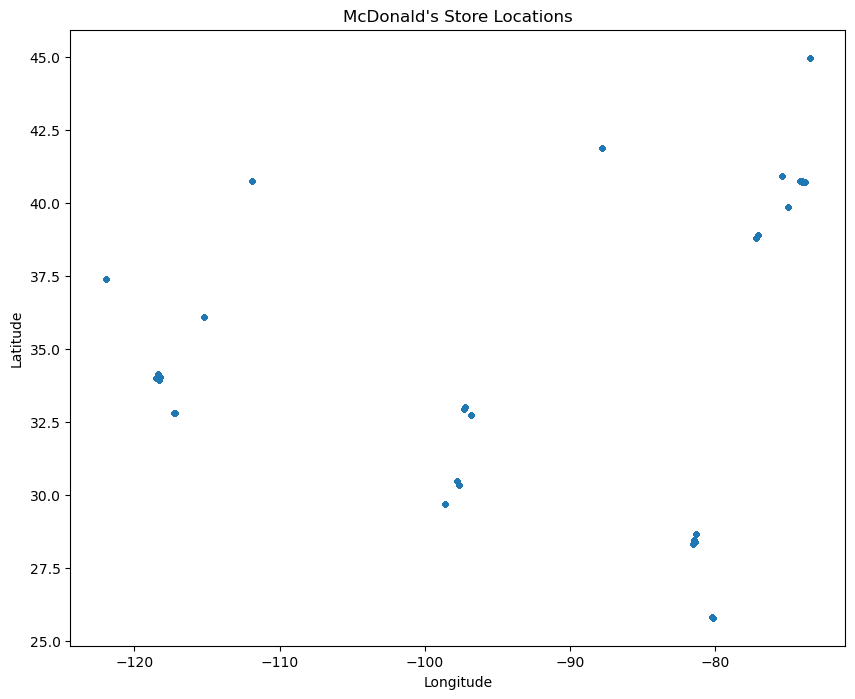

In [12]:
# Plotting the store locations
plt.figure(figsize=(10, 8))
plt.scatter(df['longitude'], df['latitude '], s=10, alpha=0.5)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('McDonald\'s Store Locations')
plt.show()


# Heatmap Visualization
To analyze high-performing or underperforming regions based on ratings, we can create a heatmap. The heatmap will provide an aggregated view of the ratings by region.

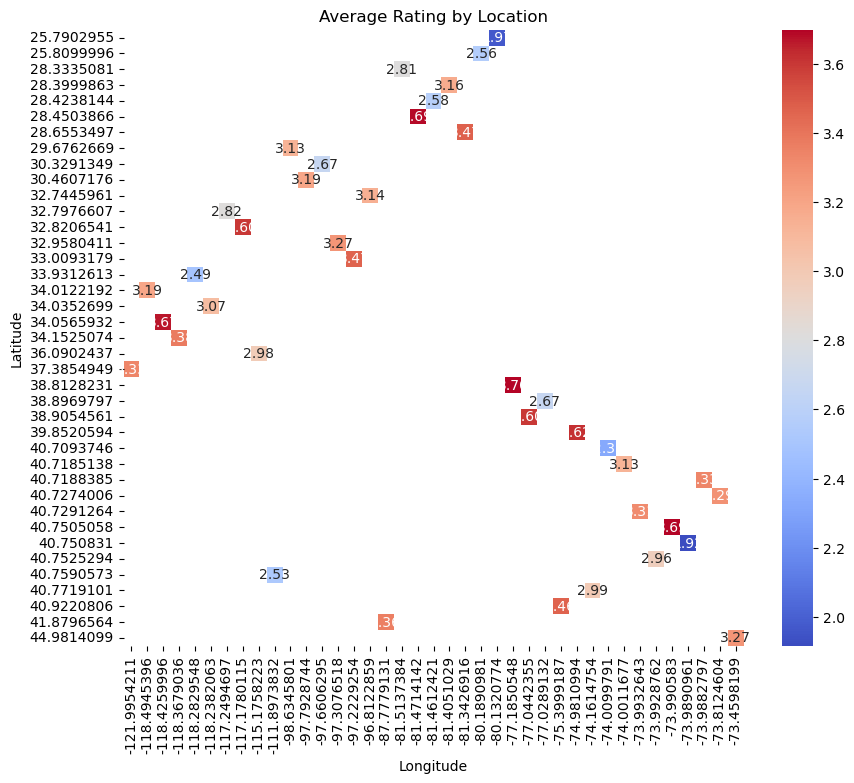

In [13]:
# Grouping by latitude and longitude and calculating average rating
avg_rating_by_location = df.groupby(['latitude ', 'longitude'])['rating'].mean().reset_index()

# Plotting the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(data=avg_rating_by_location.pivot(index='latitude ', columns='longitude', values='rating'),cmap='coolwarm', annot=True, fmt='.2f')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Average Rating by Location')
plt.show()



## Geospatial Analysis
For a more detailed analysis, we can utilize geospatial libraries such as GeoPandas or Folium to plot the store locations on a map and overlay additional information like reviews or other variables of interest.
Here's an example using Folium to create an interactive map with store locations and popup information:

In [14]:
import folium

# Create a map centered on the US
map_us = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

# Add markers for each store location with popup information
for index, row in df.iterrows():
    popup_text = f"Store Name: {row['store_name']}<br>Rating: {row['rating']}<br>Review: {row['review']}"
    folium.Marker([row['latitude '], row['longitude']], popup=popup_text).add_to(map_us)

# Display the map
map_us
